<a href="https://colab.research.google.com/github/Simone000001/5590_ass2/blob/main/ass_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
# import enquired package
!pip install mapclassify
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import statsmodels.api as sm
import subprocess
import sys
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import Normalize
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable
from sklearn.preprocessing import MinMaxScaler
import warnings
warnings.filterwarnings('ignore')

In [6]:
# import fils of .csv format
from google.colab import files
files.upload()

Saving total_hh.csv to total_hh.csv
Saving total_resi.csv to total_resi.csv


{'total_hh.csv': b'\xef\xbb\xbflsoa11cd,Household Composition: All categories: Household composition; measures: Value,Household Composition: One person household: Aged 65 and over; measures: Value,Household Composition: One family only: Lone parent; measures: Value,Household Composition: No adults in employment in household: With dependent children; measures: Value\r\nE01011264,565,91,62,13\r\nE01011265,748,168,52,10\r\nE01011266,893,52,47,6\r\nE01011267,666,116,80,23\r\nE01011268,615,76,95,37\r\nE01011269,735,133,69,16\r\nE01011270,649,66,22,7\r\nE01011271,903,103,74,10\r\nE01011272,571,39,52,5\r\nE01011273,700,87,52,22\r\nE01011274,680,128,87,37\r\nE01011275,602,85,60,14\r\nE01011276,611,66,54,17\r\nE01011277,607,39,65,9\r\nE01011278,716,91,57,16\r\nE01011279,573,86,42,8\r\nE01011280,715,59,58,6\r\nE01011281,824,64,103,66\r\nE01011282,610,72,90,31\r\nE01011283,538,55,109,68\r\nE01011284,878,50,115,68\r\nE01011286,538,50,43,14\r\nE01011287,599,75,60,17\r\nE01011292,823,148,107,60\r\nE

In [7]:
# data pre-processing
# calculate percentage of each facter from total_hh, select them from original excel and make them as a new dataframe called new_hh
# load data
data = pd.read_csv('total_hh.csv')
# claculate the percentage fo each factor in total_hh
data['perc_one_person65+'] = (data['Household Composition: One person household: Aged 65 and over; measures: Value'] / data['Household Composition: All categories: Household composition; measures: Value'])
data['perc_lone_parent'] = (data['Household Composition: One family only: Lone parent; measures: Value'] / data['Household Composition: All categories: Household composition; measures: Value'])
data['perc_noad_em'] = (data['Household Composition: No adults in employment in household: With dependent children; measures: Value'] / data['Household Composition: All categories: Household composition; measures: Value'])

new_hh = data[['lsoa11cd', 'perc_one_person65+', 'perc_lone_parent', 'perc_noad_em']]
print(new_hh)

      lsoa11cd  perc_one_person65+  perc_lone_parent  perc_noad_em
0    E01011264            0.161062          0.109735      0.023009
1    E01011265            0.224599          0.069519      0.013369
2    E01011266            0.058231          0.052632      0.006719
3    E01011267            0.174174          0.120120      0.034535
4    E01011268            0.123577          0.154472      0.060163
..         ...                 ...               ...           ...
477  E01033031            0.075448          0.040921      0.026854
478  E01033032            0.046895          0.039290      0.021546
479  E01033033            0.058108          0.039189      0.016216
480  E01033034            0.015504          0.004651      0.004651
481  E01033035            0.038564          0.107713      0.105053

[482 rows x 4 columns]


In [8]:
# calculate percentage of each facter from total_resi, select them from original excel and make them as a new dataframe called new_resi
# load dataframe
data = pd.read_csv('total_resi.csv')
# calculate the percentage of each factors
data['perc_commu'] = (data['Variable: Lives in a communal establishment; measures: Value'] / data['Variable: All usual residents; measures: Value'])
data['perc_stu'] = (data['Variable: Schoolchild or full-time student aged 4 and over at their non term-time address; measures: Value'] / data['Variable: All usual residents; measures: Value'])
# generate new dataframe
new_resi = data[['lsoa11cd', 'perc_commu', 'perc_stu']]
print(new_resi)

      lsoa11cd  perc_commu  perc_stu
0    E01011264    0.002346  0.013292
1    E01011265    0.043692  0.010462
2    E01011266    0.000000  0.021214
3    E01011267    0.000000  0.010027
4    E01011268    0.000000  0.003587
..         ...         ...       ...
477  E01033031    0.015516  0.003879
478  E01033032    0.000000  0.003130
479  E01033033    0.250000  0.003165
480  E01033034    0.000000  0.001951
481  E01033035    0.003541  0.005666

[482 rows x 3 columns]


In [9]:
# merge two dataframe and check the construction of this new dataframe
merge_df = pd.merge(new_hh, new_resi, on='lsoa11cd', how='inner')
print(merge_df.head())
print(merge_df.info())

    lsoa11cd  perc_one_person65+  perc_lone_parent  perc_noad_em  perc_commu  \
0  E01011264            0.161062          0.109735      0.023009    0.002346   
1  E01011265            0.224599          0.069519      0.013369    0.043692   
2  E01011266            0.058231          0.052632      0.006719    0.000000   
3  E01011267            0.174174          0.120120      0.034535    0.000000   
4  E01011268            0.123577          0.154472      0.060163    0.000000   

   perc_stu  
0  0.013292  
1  0.010462  
2  0.021214  
3  0.010027  
4  0.003587  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 482 entries, 0 to 481
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   lsoa11cd            482 non-null    object 
 1   perc_one_person65+  482 non-null    float64
 2   perc_lone_parent    482 non-null    float64
 3   perc_noad_em        482 non-null    float64
 4   perc_commu          482 non-null

In [10]:
# look at the first 5 rows of the dataframe
merge_df.head()

,lsoa11cd,perc_one_person65+,perc_lone_parent,perc_noad_em,perc_commu,perc_stu
0,E01011264,0.161062,0.109735,0.023009,0.002346,0.013292
1,E01011265,0.224599,0.069519,0.013369,0.043692,0.010462
2,E01011266,0.058231,0.052632,0.006719,0.000000,0.021214
3,E01011267,0.174174,0.120120,0.034535,0.000000,0.010027
4,E01011268,0.123577,0.154472,0.060163,0.000000,0.003587


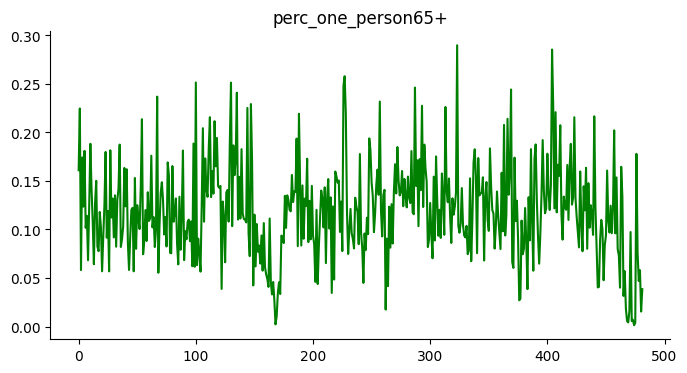

In [15]:
# title perc_one_person65+
merge_df['perc_one_person65+'].plot(kind='line', figsize=(8, 4),color='green', title='perc_one_person65+')
plt.gca().spines[['top', 'right']].set_visible(False)

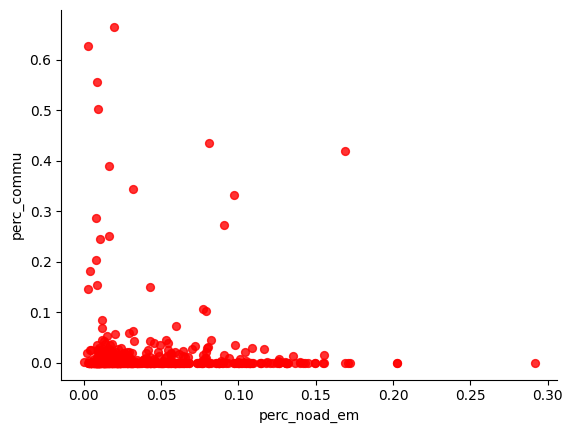

In [16]:
# title perc_noad_em vs perc_commu
merge_df.plot(kind='scatter', x='perc_noad_em', y='perc_commu', s=32, color='red', alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

In [17]:
# summary statistics
merge_df.describe()

,perc_one_person65+,perc_lone_parent,perc_noad_em,perc_commu,perc_stu
count,482.000000,482.000000,482.000000,482.000000,482.000000
mean,0.118973,0.109230,0.044560,0.018956,0.010204
std,0.049342,0.057377,0.041700,0.072025,0.007246
min,0.001372,0.002821,0.000000,0.000000,0.000581
25%,0.088741,0.067793,0.013649,0.000000,0.004607
50%,0.117480,0.095367,0.028250,0.000000,0.008330
75%,0.145235,0.141903,0.062577,0.009439,0.013396
max,0.289665,0.369863,0.291585,0.664822,0.037466


In [18]:
# describe two columes in the merge_df
merge_df[['perc_one_person65+','perc_commu']].describe()

,perc_one_person65+,perc_commu
count,482.000000,482.000000
mean,0.118973,0.018956
std,0.049342,0.072025
min,0.001372,0.000000
25%,0.088741,0.000000
50%,0.117480,0.000000
75%,0.145235,0.009439
max,0.289665,0.664822


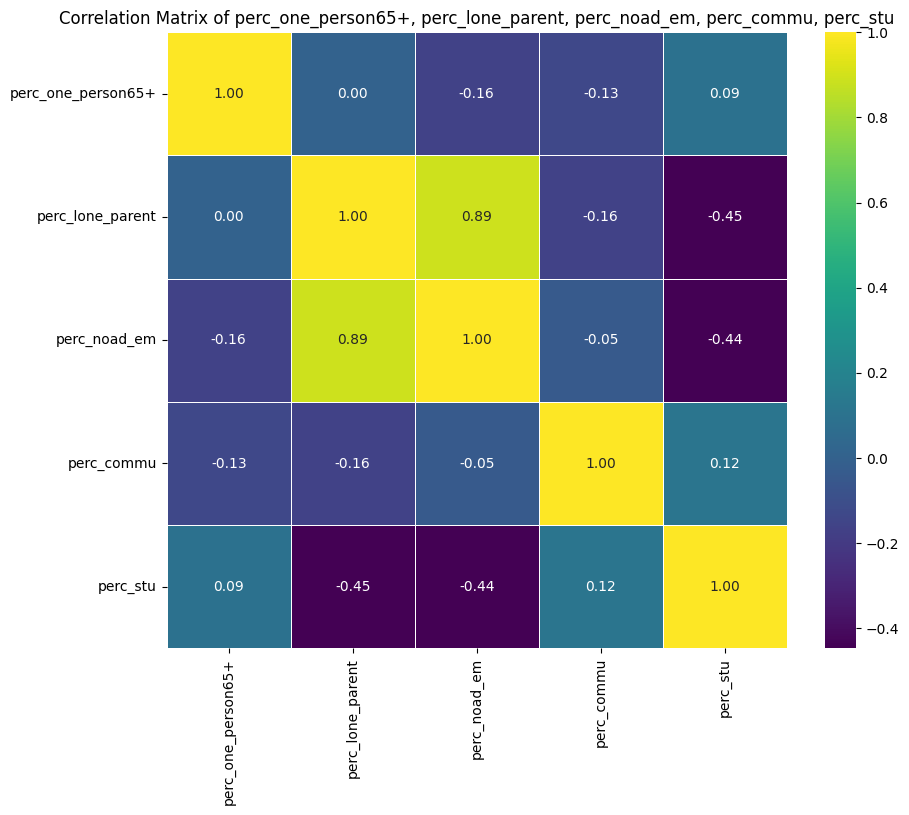

In [19]:
# colleration analyse
columns = ['perc_one_person65+', 'perc_lone_parent', 'perc_noad_em', 'perc_commu', 'perc_stu']
subset_df = merge_df[columns]
corr_matrix = subset_df.corr()
# create heatmap using correlation matris of
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='viridis', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of perc_one_person65+, perc_lone_parent, perc_noad_em, perc_commu, perc_stu')
plt.show()

In [20]:
# the two factors 'perc_noad_em' and 'perc_lone_parent' show high correlation, and collinearity analysis needs to be performed on them.
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
df_vif = merge_df[['perc_noad_em', 'perc_lone_parent']]

df_vif = add_constant(df_vif)

vif_data = pd.DataFrame()
vif_data["feature"] = df_vif.columns

vif_data["VIF"] = [variance_inflation_factor(df_vif.values, i) for i in range(df_vif.shape[1])]

print(vif_data)

            feature       VIF
0             const  6.477978
1      perc_noad_em  4.749044
2  perc_lone_parent  4.749044


In [21]:
# check whether there is a null value in merge_df
has_null = merge_df.isnull().values.any()
print(f"Does the DataFrame have any null values? {has_null}")

Does the DataFrame have any null values? False


Shapiro-Wilk Test for perc_one_person65+: Statistics=0.9878926873207092, p-value=0.0004991940222680569
perc_one_person65+ data not consistent with normal distribution
Shapiro-Wilk Test for perc_lone_parent: Statistics=0.9472783803939819, p-value=4.498347441067585e-12
perc_lone_parent data not consistent with normal distribution
Shapiro-Wilk Test for perc_noad_em: Statistics=0.8321094512939453, p-value=3.9417077222228163e-22
perc_noad_em data not consistent with normal distribution
Shapiro-Wilk Test for perc_commu: Statistics=0.27174973487854004, p-value=1.2180632758312397e-39
perc_commu data not consistent with normal distribution
Shapiro-Wilk Test for perc_stu: Statistics=0.8852797746658325, p-value=1.8519835656365586e-18
perc_stu data not consistent with normal distribution


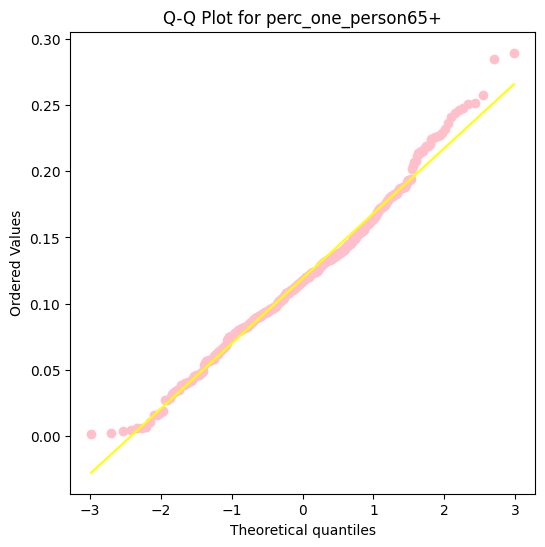

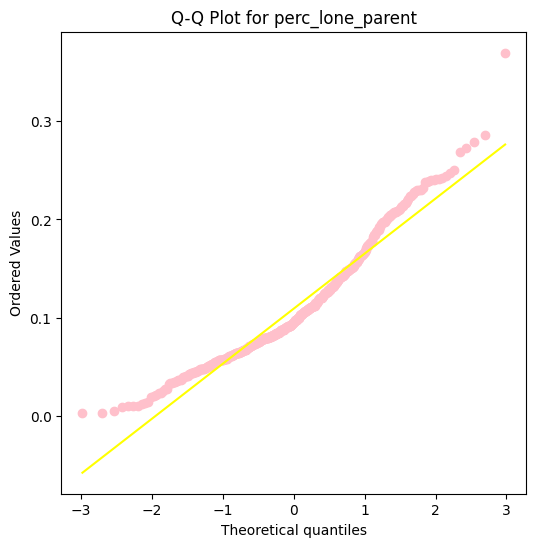

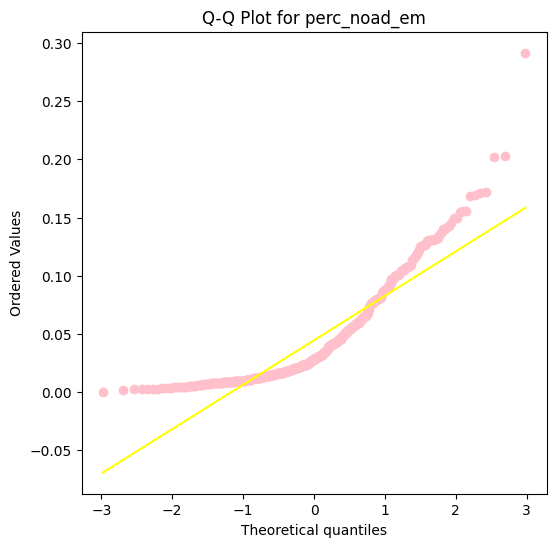

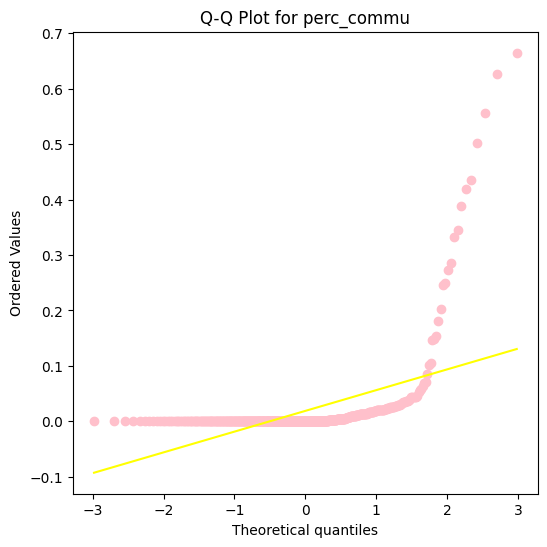

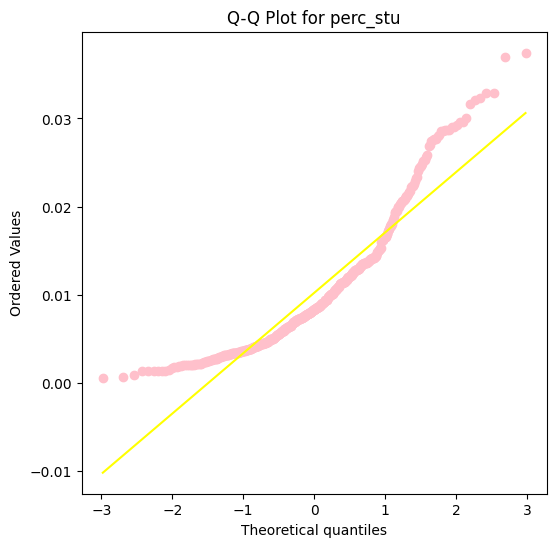

In [22]:
# check whther the data consistent with normal distribution
columns = ['perc_one_person65+', 'perc_lone_parent', 'perc_noad_em', 'perc_commu', 'perc_stu']
from scipy import stats
subprocess.check_call([sys.executable, '-m', 'pip', 'install', 'scipy', 'matplotlib'])
subset_df = merge_df[columns]
for col in columns:
    stat, p = stats.shapiro(subset_df[col])
    print(f"Shapiro-Wilk Test for {col}: Statistics={stat}, p-value={p}")
    alpha = 0.05
    if p > alpha:
        print(f"{col} data consistent with normal distribution")
    else:
        print(f"{col} data not consistent with normal distribution")

# draw Q-Q plot
for col in columns:
    fig = plt.figure(figsize=(6, 6))
    ax = fig.add_subplot(111)
    stats.probplot(subset_df[col], dist="norm", plot=ax)
    ax.get_lines()[0].set_color('pink')
    ax.get_lines()[1].set_color('yellow')
    ax.set_title(f"Q-Q Plot for {col}")
    plt.show()

In [24]:
# use discrete normalization to normalize each of the five factors
columns_to_standardized = ['perc_one_person65+', 'perc_lone_parent', 'perc_noad_em', 'perc_commu', 'perc_stu']
subset_df = merge_df[columns]
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(subset_df)
scaled_df = pd.DataFrame(scaled_data, columns=columns)
scaled_df.insert(0, 'lsoa11cd', merge_df['lsoa11cd'])
print(scaled_df.head())

    lsoa11cd  perc_one_person65+  perc_lone_parent  perc_noad_em  perc_commu  \
0  E01011264            0.553915          0.291284      0.078910    0.003528   
1  E01011265            0.774305          0.181717      0.045849    0.065720   
2  E01011266            0.197226          0.135708      0.023043    0.000000   
3  E01011267            0.599398          0.319580      0.118437    0.000000   
4  E01011268            0.423893          0.413170      0.206329    0.000000   

   perc_stu  
0  0.344595  
1  0.267867  
2  0.559373  
3  0.256079  
4  0.081481  


In [25]:
# generate the deperivation index for each lsoa
scaled_df['index'] = scaled_df[columns].sum(axis=1)
print(scaled_df.head())

    lsoa11cd  perc_one_person65+  perc_lone_parent  perc_noad_em  perc_commu  \
0  E01011264            0.553915          0.291284      0.078910    0.003528   
1  E01011265            0.774305          0.181717      0.045849    0.065720   
2  E01011266            0.197226          0.135708      0.023043    0.000000   
3  E01011267            0.599398          0.319580      0.118437    0.000000   
4  E01011268            0.423893          0.413170      0.206329    0.000000   

   perc_stu     index  
0  0.344595  1.272233  
1  0.267867  1.335459  
2  0.559373  0.915350  
3  0.256079  1.293493  
4  0.081481  1.124873  


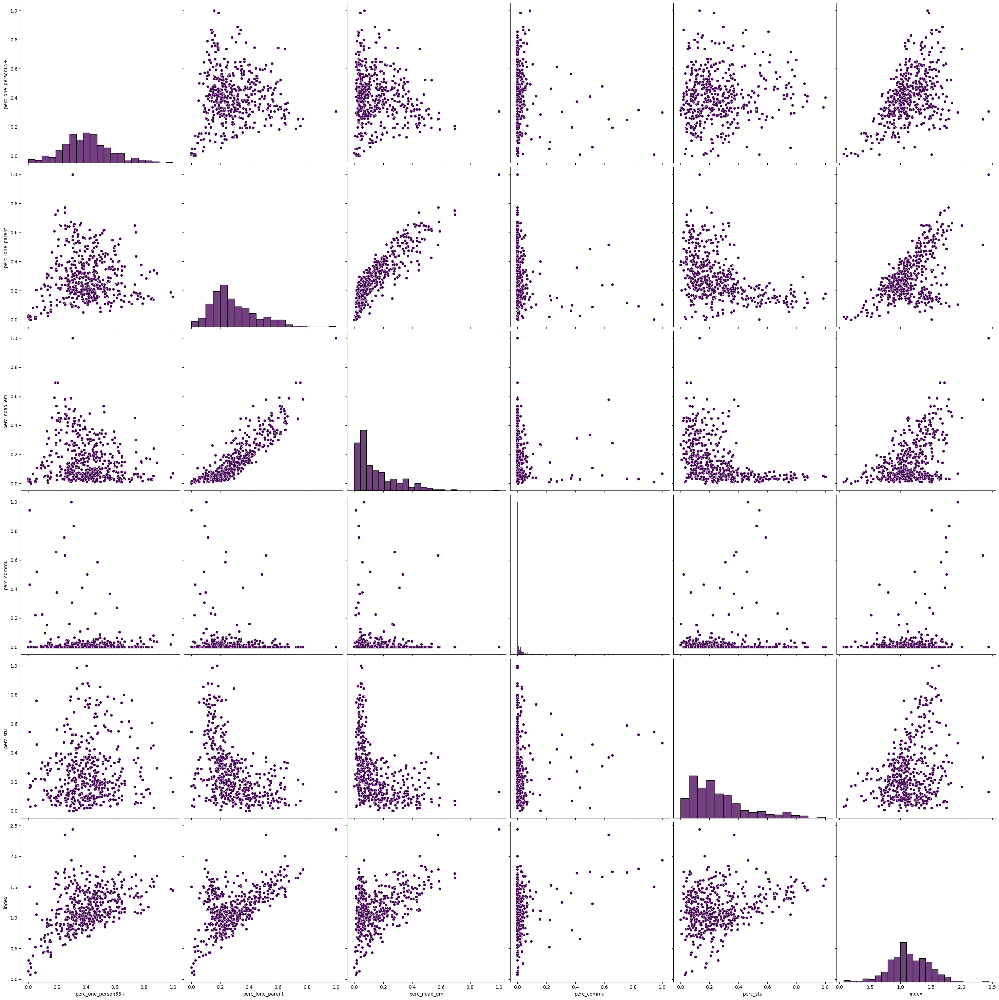

In [26]:
# show relationships between multiple variables in scaled_df
colors = plt.cm.viridis(np.linspace(0, 1, 10))
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=colors)

# use pairplot to draw relationship diagrams
sns.pairplot(scaled_df[['perc_one_person65+',
                        'perc_lone_parent',
                        'perc_noad_em',
                        'perc_commu',
                        'perc_stu',
                        'index']],
             height=5)

In [27]:
#import geospatial information data and merge scaled_df
from google.colab import files
files.upload()

Saving Leeds.geojson to Leeds.geojson


{'Leeds.geojson': b'{\n"type": "FeatureCollection",\n"crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:EPSG::27700" } },\n"features": [\n{ "type": "Feature", "properties": { "FID": 10720, "LSOA21CD": "E01011264", "LSOA21NM": "Leeds 011A", "BNG_E": 420937, "BNG_N": 441836, "LONG": -1.68306, "LAT": 53.87232, "GlobalID": "14a73329-fc8f-464c-a4fa-1963baa35500" }, "geometry": { "type": "Polygon", "coordinates": [ [ [ 421248.688000000023749, 442315.812000001023989 ], [ 421284.0725, 442306.911499998997897 ], [ 421307.406000000017229, 442314.687000001023989 ], [ 421321.479, 442317.191 ], [ 421327.781000000017229, 442318.311000000976492 ], [ 421343.533999999985099, 442323.61099999997532 ], [ 421354.761, 442327.38900000002468 ], [ 421364.593999999982771, 442297.812000001023989 ], [ 421372.688000000023749, 442281.594000000972301 ], [ 421375.593999999982771, 442276.812000001023989 ], [ 421381.055999999982305, 442270.199999999022111 ], [ 421404.688000000023749, 442241.59400000097230

In [28]:
leeds_shp =gpd.read_file('Leeds.geojson')
leeds_shp.head()

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,10720,E01011264,Leeds 011A,420937,441836,-1.68306,53.87232,14a73329-fc8f-464c-a4fa-1963baa35500,"POLYGON ((421248.688 442315.812, 421284.073 44..."
1,10721,E01011265,Leeds 009A,418988,441951,-1.71269,53.87343,eda471dd-f408-4dab-917e-c5e188310b35,"POLYGON ((418635.000 442559.000, 418637.555 44..."
2,10722,E01011266,Leeds 008A,417489,442615,-1.73545,53.87945,286c32c5-ef49-4ecc-a45e-57630c165c62,"POLYGON ((417783.688 443382.312, 417788.688 44..."
3,10723,E01011267,Leeds 009B,419641,442025,-1.70276,53.87407,318cfaa3-9f08-4d61-a30e-82e903f3a7ba,"POLYGON ((419607.843 442388.568, 419612.752 44..."
4,10724,E01011268,Leeds 010A,420224,441935,-1.69390,53.87324,049e79f0-cd9e-47dc-848b-b6d6fa6825ac,"POLYGON ((420442.406 442436.687, 420443.313 44..."


In [29]:
#explore area of Leeds
leeds_shp.explore()

In [30]:
# join the index data to the leeds_shp geodataframe using a lefthand join, on the common ID 'LSOA21CD'/'lsoa21cd'
leeds_index =leeds_shp.merge(scaled_df, how='left',left_on='LSOA21CD',right_on='lsoa11cd')
leeds_index.columns

Index(['FID', 'LSOA21CD', 'LSOA21NM', 'BNG_E', 'BNG_N', 'LONG', 'LAT',
       'GlobalID', 'geometry', 'lsoa11cd', 'perc_one_person65+',
       'perc_lone_parent', 'perc_noad_em', 'perc_commu', 'perc_stu', 'index'],
      dtype='object')

In [58]:
# check coordinate of 'leeds_index.shp'
print("leeds_index CRS:", leeds_index.crs)

leeds_index CRS: EPSG:27700


In [31]:
# find out where is higher index of deprivation in leeds
leeds_index.explore('index', cmap='YlGnBu')

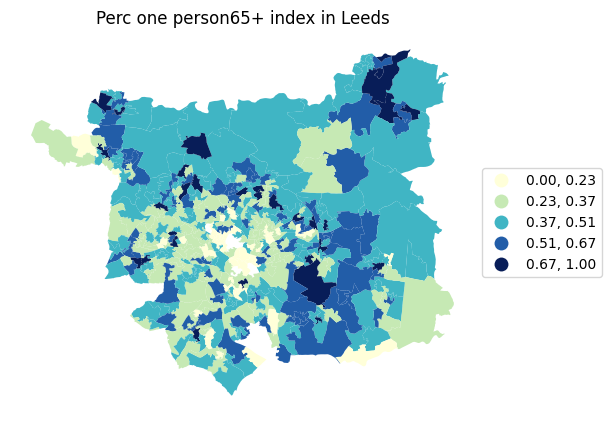

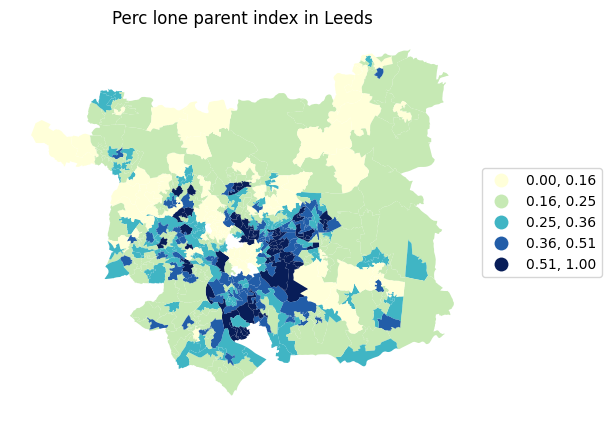

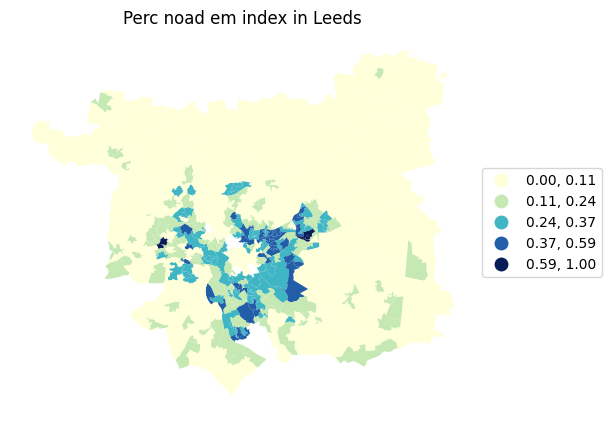

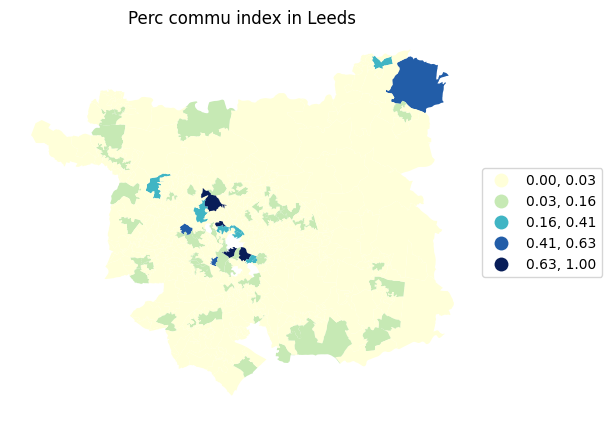

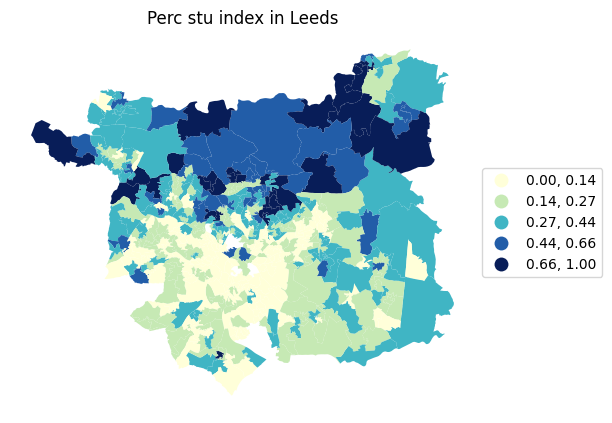

In [32]:
# create a list of the columns we want to plot
decile_cols =['perc_one_person65+', 'perc_lone_parent', 'perc_noad_em', 'perc_commu',
       'perc_stu']

# create a for loop for plotting a map of each domain

# for each item in a range from 0 to 5 (number of items in the deciles_cols list)
for i in range (0, len(decile_cols)):

    # produce a plot
    fig, ax = plt.subplots(1, 1, figsize=(6, 6))

    # get the ith item in the decile column list and plot
    leeds_index.plot(column=decile_cols[i],


    #### format the plot ###

    # reduce linewidth between polygons
    linewidth =0.1,
    # specify data is categorical (ordinal)
    categorical=True,
    # show the legend
    legend=True,
    scheme='fisher_jenks',
    # define the legend palette
    cmap='YlGnBu',
    # use the define axis
    ax=ax,
    # position the legend
    legend_kwds={'loc': 'center left','bbox_to_anchor':(1,0.5)})

    # add a title based on the column plotted, formatting the title to look better
    plt.title(decile_cols[i].replace('_',' ').replace('pp dec index ','').capitalize()+' index in Leeds')

    # do not plot with the axis showing
    plt.axis('off')

    # save the figure as an image with name reflecting the domain plotted
    plt.savefig(str(decile_cols[i])+'_'+'Leeds'+'.jpg',bbox_inches='tight');

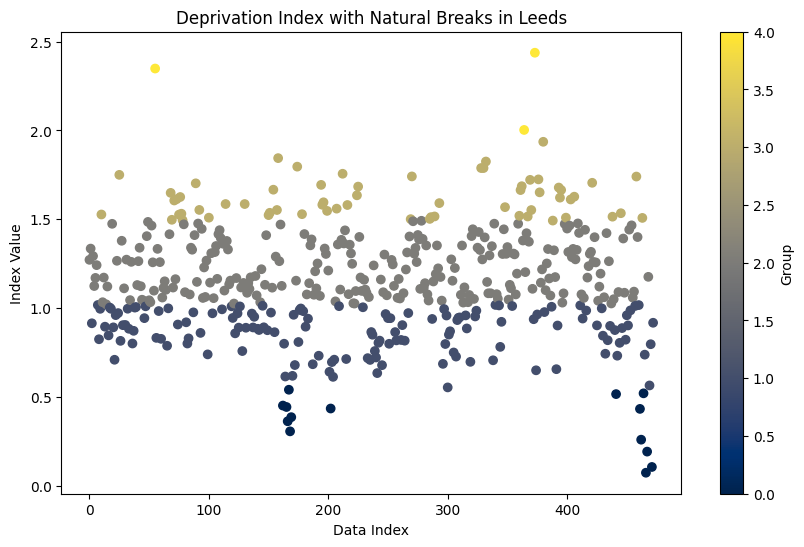

In [33]:
# create a map to show the distribution of deprivation index in leeds
# use natural breakpoints to divide the data into five groups
bins = pd.cut(leeds_index['index'], bins=5, labels=False)
# clor the map
cmap = cm.get_cmap('cividis')
# create sxis and graph
fig, ax = plt.subplots(figsize=(10, 6))
# create scatter graph
sc = ax.scatter(leeds_shp.index, leeds_index['index'], c=bins, cmap=cmap, marker='o')
# create a color map
norm = Normalize(vmin=bins.min(), vmax=bins.max())
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
# add color bar
cbar = fig.colorbar(sm)
cbar.set_label('Group')
# add tittle and labels
plt.title('Deprivation Index with Natural Breaks in Leeds')
plt.xlabel('Data Index')
plt.ylabel('Index Value')
# show plot
plt.show()

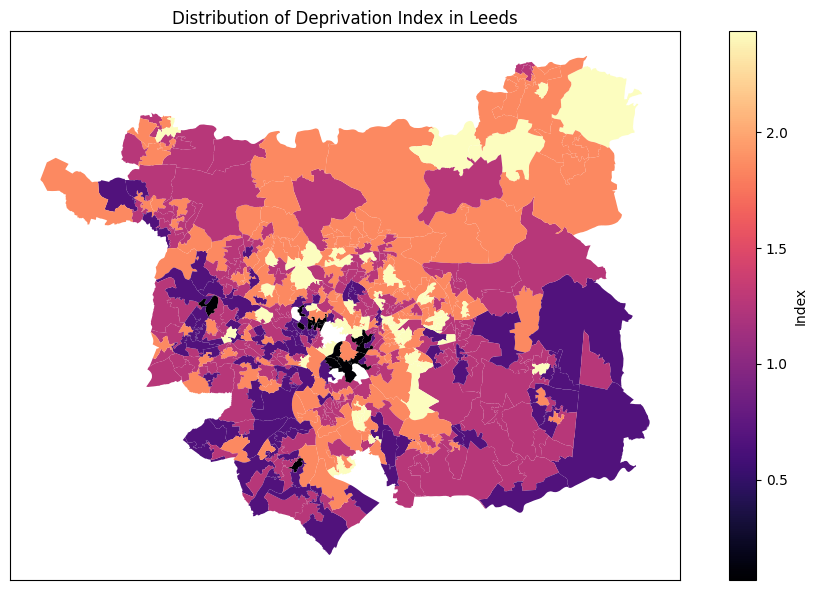

In [34]:
#create a map to show the spatial distribution of deprivation index in leeds
fig, ax = plt.subplots(figsize=(10, 6))
# generate a map
leeds_index.plot(column='index', cmap='magma', categorical=True, scheme='fisher_jenks', ax=ax)
# add title
ax.set_title('Distribution of Deprivation Index in Leeds', pad=5)
# set the position of legend
cmap = plt.cm.get_cmap('magma')
norm = plt.Normalize(leeds_index['index'].max(), leeds_index['index'].min())
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('Index')
# hide xy axis latitude and longitude
ax.set_xticks([])
ax.set_yticks([])
# adjust the layout
plt.tight_layout()
# show the plot
plt.show()

In [35]:
# import crime data
from google.colab import files
uploaded = files.upload()


Saving 2024-03-west-yorkshire-street.csv to 2024-03-west-yorkshire-street.csv


In [36]:
# read CSV file
import io
df = pd.read_csv(io.BytesIO(uploaded['2024-03-west-yorkshire-street.csv']))
file_path = '2024-03-west-yorkshire-street.csv'
crime = pd.read_csv(io.BytesIO(uploaded[file_path]))
# view the first few rows of data
df.head()
# check if there are missing values
df.isnull().sum()
# delete rows containing missing values
df.dropna(inplace=True)
# check data type
df.dtypes


Crime ID                  object
Month                     object
Reported by               object
Falls within              object
Longitude                float64
Latitude                 float64
Location                  object
LSOA code                 object
LSOA name                 object
Crime type                object
Last outcome category     object
Context                  float64
dtype: object

In [50]:
# read the CSV file and name it crime
file_path = '2024-03-west-yorkshire-street.csv'
crime = pd.read_csv(io.BytesIO(uploaded[file_path]))
# filter rows 12080 to 21487
crime_subset = crime.iloc[12079:21487]
leeds_crime = crime_subset[['Longitude', 'Latitude', 'LSOA code', 'Crime type']]
# show results
print(leeds_crime.head())
print(leeds_crime.tail())

       Longitude   Latitude  LSOA code                    Crime type
12079  -1.391358  53.938031  E01011698                   Shoplifting
12080  -1.391358  53.938031  E01011698                   Shoplifting
12081  -1.391358  53.938031  E01011698                   Shoplifting
12082  -1.388135  53.938661  E01011698  Violence and sexual offences
12083  -1.387994  53.939973  E01011699     Criminal damage and arson
       Longitude   Latitude  LSOA code                    Crime type
21482  -1.535003  53.792645  E01035054  Violence and sexual offences
21483  -1.533756  53.790070  E01035054  Violence and sexual offences
21484  -1.537106  53.793228  E01035054                   Other crime
21485  -1.533069  53.789087  E01035054                   Other crime
21486  -1.973930  53.568929  E01005410         Anti-social behaviour


Crime type
Violence and sexual offences    3531
Shoplifting                     1063
Public order                     825
Criminal damage and arson        686
Vehicle crime                    659
Anti-social behaviour            627
Other theft                      606
Burglary                         498
Other crime                      274
Drugs                            257
Robbery                          131
Theft from the person             90
Possession of weapons             87
Bicycle theft                     74
Name: count, dtype: int64


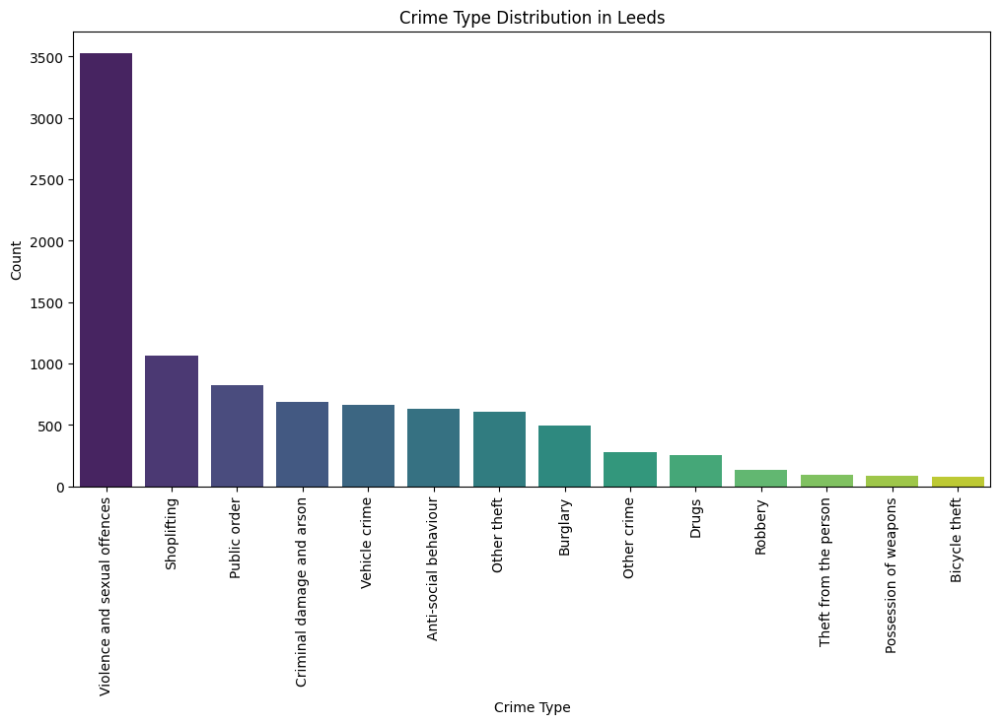

In [51]:
# count the number of occurrences of different types of crimes
crime_counts = leeds_crime['Crime type'].value_counts()

# print statistical results to ensure there is data
print(crime_counts)

# visualize crime type distribution
plt.figure(figsize=(12, 6))
sns.barplot(x=crime_counts.index, y=crime_counts.values, palette='viridis')
plt.xticks(rotation=90)
plt.title('Crime Type Distribution in Leeds')
plt.xlabel('Crime Type')
plt.ylabel('Count')
plt.show()
plt.show()

LSOA code
E01033010    652
E01033011    198
E01033016    110
E01011484     96
E01033008     82
E01011531     80
E01011369     76
E01011341     67
E01035054     67
E01033035     64
E01011729     64
E01011364     61
E01033031     59
E01011336     58
E01011622     57
E01033002     55
E01011343     55
E01011433     55
E01011371     54
E01011342     54
Name: count, dtype: int64


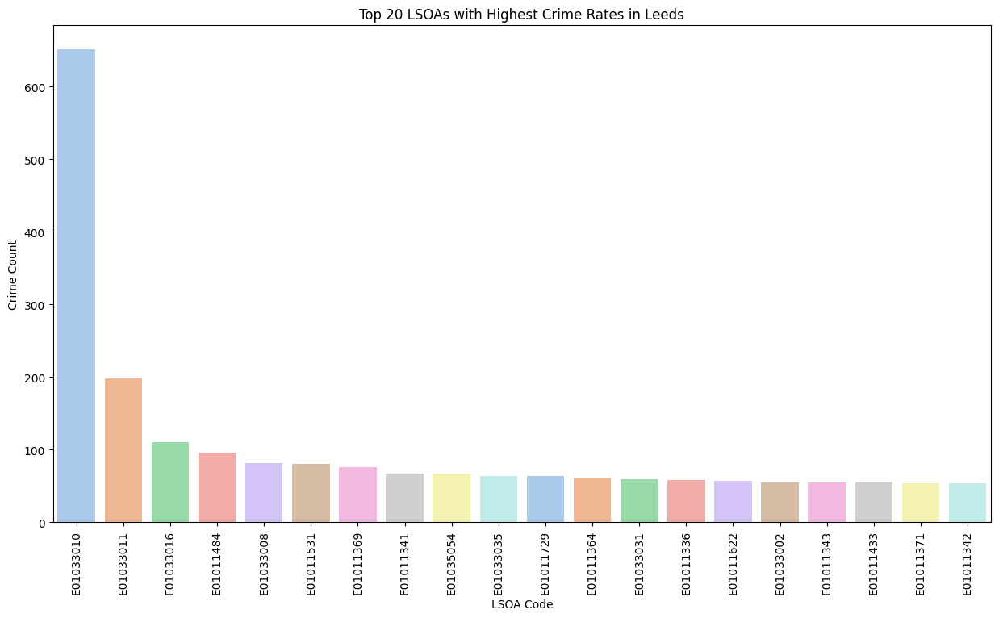

In [53]:
# count the number of crimes by LSOA code
lsoa_crime_counts = leeds_crime['LSOA code'].value_counts()

# print statistical results to ensure there is data
print(lsoa_crime_counts.head(20))

# visualize crime distribution by LSOA code
plt.figure(figsize=(15, 8))
sns.barplot(x=lsoa_crime_counts.index[:20], y=lsoa_crime_counts.values[:20], palette='pastel')
plt.xticks(rotation=90)
plt.title('Top 20 LSOAs with Highest Crime Rates in Leeds')
plt.xlabel('LSOA Code')
plt.ylabel('Crime Count')
plt.show()

In [87]:
# Load population data
population_data = pd.read_csv('total_resi.csv')

# Assuming leeds_crime is already loaded and contains the 'LSOA code'
# Count the number of crimes by LSOA code
lsoa_crime_counts = leeds_crime['LSOA code'].value_counts().reset_index()
lsoa_crime_counts.columns = ['LSOA code', 'Crime Count']

# Merge crime data with population data
# Ensure the merge columns are correctly aligned in name or specify left_on and right_on parameters
merged_data = pd.merge(lsoa_crime_counts, population_data, how='left', left_on='LSOA code', right_on='lsoa11cd')

# Calculate crime rate per 1,000 residents
# 'Variable: All usual residents; measures: Value' contains the population
merged_data['rate_1000'] = (merged_data['Crime Count'] / merged_data['Variable: All usual residents; measures: Value']) * 1000

# Display the first few rows to check the results
print(merged_data.head())

   LSOA code  Crime Count   lsoa11cd  \
0  E01033010          652  E01033010   
1  E01033011          198  E01033011   
2  E01033016          110  E01033016   
3  E01011484           96  E01011484   
4  E01033008           82  E01033008   

   Variable: All usual residents; measures: Value  \
0                                          2807.0   
1                                          1373.0   
2                                          1017.0   
3                                          1538.0   
4                                          1120.0   

   Variable: Lives in a communal establishment; measures: Value  \
0                                             1760.0              
1                                              201.0              
2                                                2.0              
3                                                0.0              
4                                               28.0              

   Variable: Schoolchild or full-time

In [91]:
print("Columns in merged_data:", merged_data.columns)
print("Columns in leeds_index:", leeds_index.columns)

Columns in merged_data: Index(['LSOA code', 'Crime Count', 'lsoa11cd',
       'Variable: All usual residents; measures: Value',
       'Variable: Lives in a communal establishment; measures: Value',
       'Variable: Schoolchild or full-time student aged 4 and over at their non term-time address; measures: Value',
       'rate_1000'],
      dtype='object')
Columns in leeds_index: Index(['FID', 'LSOA21CD', 'LSOA21NM', 'BNG_E', 'BNG_N', 'LONG', 'LAT',
       'GlobalID', 'geometry', 'lsoa11cd', 'perc_one_person65+',
       'perc_lone_parent', 'perc_noad_em', 'perc_commu', 'perc_stu', 'index',
       'LSOA code_x', 'crime_count_x', 'LSOA code_y', 'crime_count_y',
       'LSOA code_left', 'crime_count_left', 'LSOA code_right',
       'crime_count_right', 'LSOA code', 'crime_count'],
      dtype='object')


   LSOA code  Crime Count   rate_1000
0  E01033010          652  232.276452
1  E01033011          198  144.209760
2  E01033016          110  108.161259
3  E01011484           96   62.418726
4  E01033008           82   73.214286


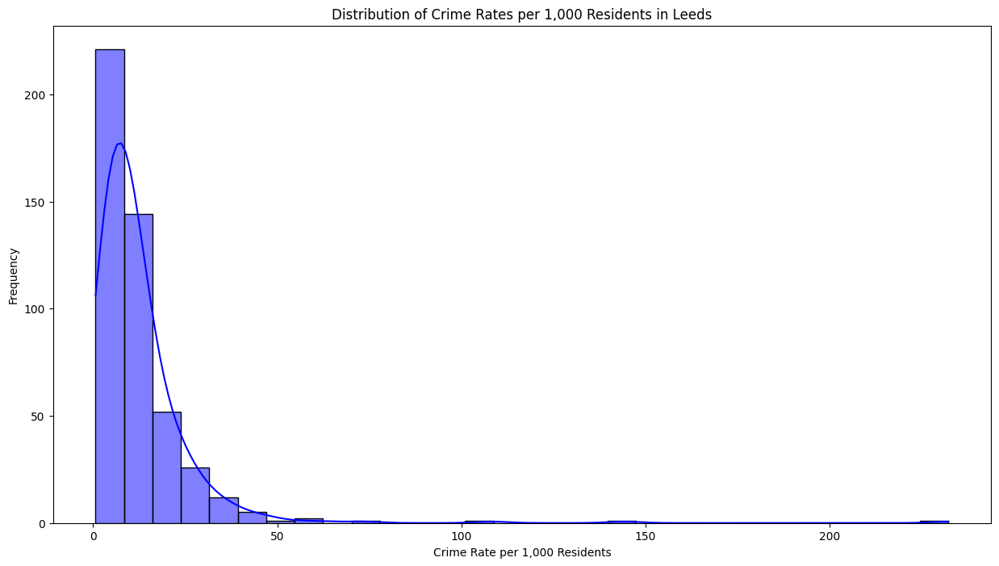

In [92]:
# extract the required columns
merged_data_subset = merged_data[['LSOA code', 'Crime Count', 'rate_1000']]
leeds_index_subset = leeds_index[['LSOA21CD']]

# merge data frames
merge_final = pd.merge(merged_data_subset, leeds_index_subset, left_on='LSOA code', right_on='LSOA21CD', suffixes=('', '_drop'))

# delete unnecessary columns and rename them
merge_final.drop(columns=['LSOA21CD'], inplace=True)

# show the first few lines after the merge to confirm
print(merge_final.head())

# visualize 'rate_1000'
plt.figure(figsize=(15, 8))
sns.histplot(merge_final['rate_1000'].dropna(), bins=30, kde=True, color='blue')
plt.title('Distribution of Crime Rates per 1,000 Residents in Leeds')
plt.xlabel('Crime Rate per 1,000 Residents')
plt.ylabel('Frequency')
plt.show()

In [55]:
# create GeoDataFrame
from shapely.geometry import Point
geometry = [Point(xy) for xy in zip(leeds_crime['Longitude'], leeds_crime['Latitude'])]
leeds_crime_gdf = gpd.GeoDataFrame(leeds_crime, geometry=geometry)
# set the coordinate system to WGS84
leeds_crime_gdf.set_crs(epsg=4326, inplace=True)

,Longitude,Latitude,LSOA code,Crime type,geometry
12079,-1.391358,53.938031,E01011698,Shoplifting,POINT (-1.39136 53.93803)
12080,-1.391358,53.938031,E01011698,Shoplifting,POINT (-1.39136 53.93803)
12081,-1.391358,53.938031,E01011698,Shoplifting,POINT (-1.39136 53.93803)
12082,-1.388135,53.938661,E01011698,Violence and sexual offences,POINT (-1.38813 53.93866)
12083,-1.387994,53.939973,E01011699,Criminal damage and arson,POINT (-1.38799 53.93997)
...,...,...,...,...,...
21482,-1.535003,53.792645,E01035054,Violence and sexual offences,POINT (-1.53500 53.79265)
21483,-1.533756,53.790070,E01035054,Violence and sexual offences,POINT (-1.53376 53.79007)
21484,-1.537106,53.793228,E01035054,Other crime,POINT (-1.53711 53.79323)
21485,-1.533069,53.789087,E01035054,Other crime,POINT (-1.53307 53.78909)


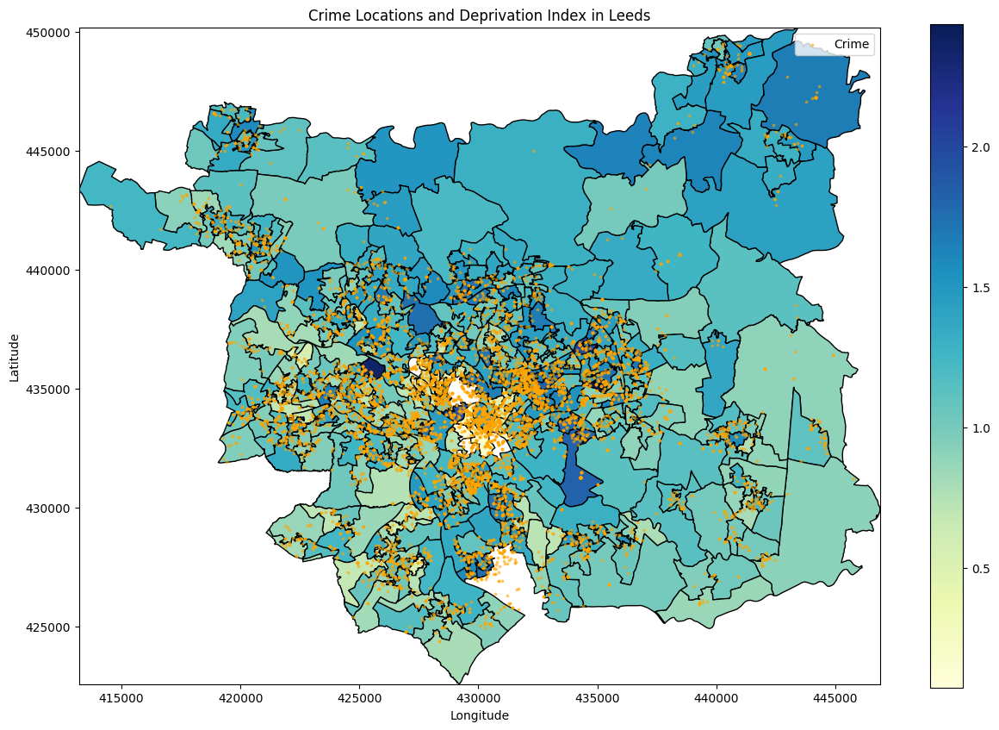

In [82]:
# convert leeds_crime_gdf to UK National Grid (EPSG:27700)
leeds_crime_gdf = leeds_crime_gdf.to_crs(epsg=27700)
# make sure the CRS for leeds_index is set to UK National Grid (EPSG:27700)
leeds_index = leeds_index.to_crs(epsg=27700)

# Assuming leeds_index and leeds_crime_gdf are GeoDataFrames properly loaded and prepared
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
leeds_index.plot(column='index', ax=ax, legend=True, cmap='YlGnBu', edgecolor='black')
# Plotting crime data
leeds_crime_gdf.plot(ax=ax, marker='o', color='orange', markersize=3, label='Crime', alpha=0.5)
# Setting plot limits based on the total bounds of leeds_index
ax.set_xlim(leeds_index.total_bounds[[0, 2]])
ax.set_ylim(leeds_index.total_bounds[[1, 3]])
# Adding labels and title
plt.legend()
plt.title('Crime Locations and Deprivation Index in Leeds')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
# Display the plot
plt.show()

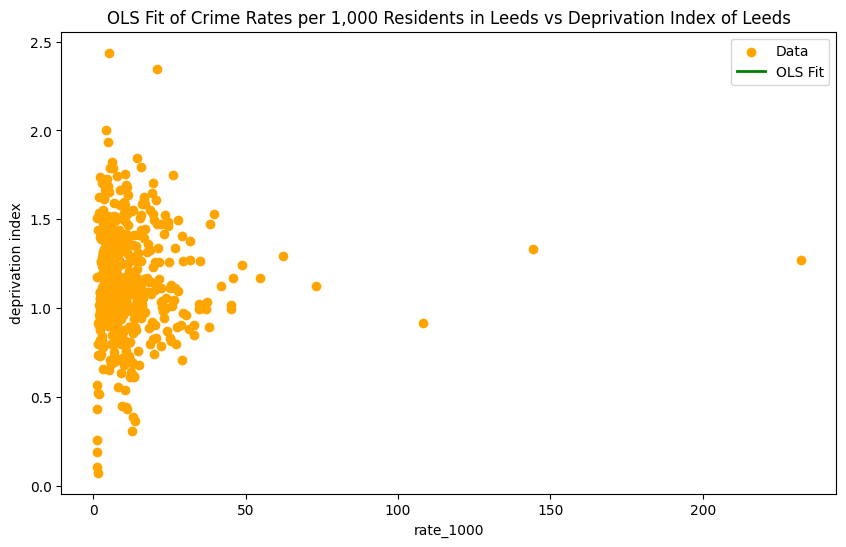

In [96]:
# 假设X已经包括常数项，y是响应变量
model = sm.OLS(y, X).fit()
predictions = model.predict(X)  # 获取模型预测值

plt.figure(figsize=(10, 6))
plt.scatter(X['rate_1000'], y, color='orange', label='Data')  # 绘制原始数据点
plt.plot(X['rate_1000'], predictions, color='green', linewidth=2, label='OLS Fit')  # 绘制拟合线
plt.xlabel('rate_1000')
plt.ylabel('deprivation index')
plt.title('OLS Fit of Crime Rates per 1,000 Residents in Leeds vs Deprivation Index of Leeds')
plt.legend()
plt.show()
